## 9 - Multiclass Feature Selection

##### Imports

In [1]:
# Import
import os
import ast
import json
import pandas as pd
import numpy as np
import scipy as su
from collections import defaultdict
# from typing import Dict
# from scipy.signal import
# from scikit-learn import

from matplotlib.path import Path
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

import dask.dataframe as dd

import pingouin as pg
import statsmodels.api as sm
from statsmodels.stats.anova import AnovaRM
import scipy.stats as stats
import pingouin as pg
from scipy.stats import ttest_rel
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import boxcox
from scipy.stats import friedmanchisquare
from scipy.stats import levene
from sklearn.ensemble import RandomForestClassifier
from sklearn.multioutput import MultiOutputClassifier
from boruta import BorutaPy

##### Data Loading (AoI)

In [70]:
# Load AoI ddfs into dictionary
root_dir = './aoi_data'
def load_aoi_data(root_dir): # Get csv file reads into one dictionary
    data = {}
    for file in os.listdir(root_dir):
        file_path = os.path.join(root_dir, file)
        file_name = os.path.splitext(file)[0]  # file name without '.csv'
        data[file_name] = dd.read_csv(file_path)  # read and attach to dict
    return data

data = load_aoi_data(root_dir)
participant_ids = [1,2,4,5,6,7,8,9,10,12,13,14,15,16,17,18,19,20]

In [71]:
# AoI features (task based)
def convert_to_list(value):
    value = value.replace('nan', 'null')
    result = json.loads(value)
    result = [np.nan if x is None else x for x in result]
    return result

df = pd.read_csv('aoi_data/aoi_features.csv', converters={
    'duration': convert_to_list,
    'fix_count': convert_to_list,
    'fix_freq': convert_to_list,
    'time_1st_fix': convert_to_list,
    'visit_count': convert_to_list,
    'visit_freq': convert_to_list,
    'visit_len': convert_to_list,
    'dwell_pct': convert_to_list,
    'stat_entropy': convert_to_list,
    'trans_entropy': convert_to_list,
})

df['condition'] =  df['difficulty'] + '_' + df['frequency']

rel_cols = ['participant_id',
 'condition',
 'difficulty',
 'frequency',
 'area',
 'instance',
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
 'stat_entropy',
 'trans_entropy'
 ]
df = df[rel_cols].reset_index(drop=True)

### 1. Correlation Matrix

##### Metrics only

In [72]:
# Explode lists (no entropies)
list_columns = [
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
 'stat_entropy',
 'trans_entropy'
]

def explode_row(row, list_columns):
    num_elements = len(row[list_columns[0]])
    expanded_rows = pd.DataFrame({
        col: [row[col]] * num_elements if col not in list_columns else row[col]
        for col in row.index
    })
    return expanded_rows

df_expanded = pd.concat(df.apply(explode_row, list_columns=list_columns, axis=1).values).reset_index(drop=True)

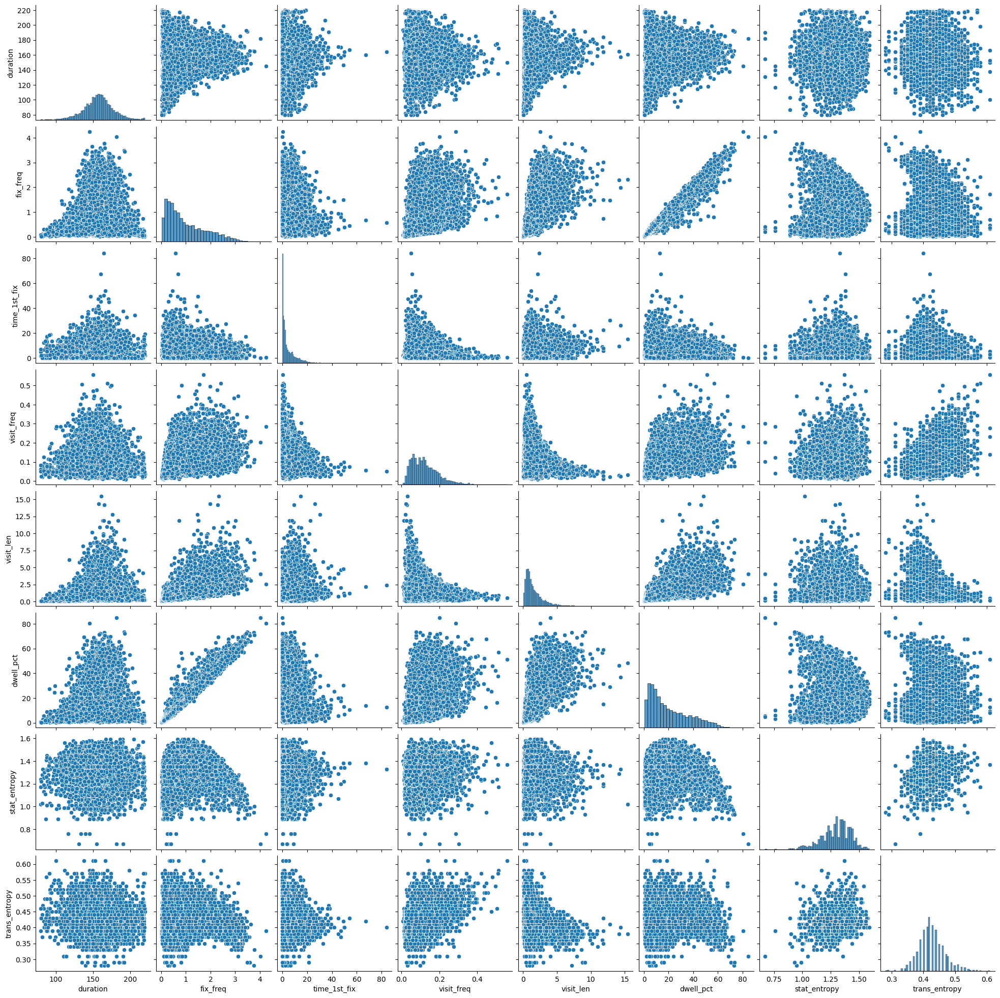

In [45]:
# Visualize pairplot
selected_columns = df_expanded[list_columns]
sns.pairplot(selected_columns)
plt.show()

In [73]:
# Compute correlation
correlation_matrix = df_expanded[list_columns].corr()
correlation_matrix

,duration,fix_freq,time_1st_fix,visit_freq,visit_len,dwell_pct,stat_entropy,trans_entropy
duration,1.000000,0.082842,-0.026885,-0.052276,0.153768,0.111591,0.018915,-0.086688
fix_freq,0.082842,1.000000,-0.012720,0.430120,0.638117,0.979232,-0.042457,-0.053756
time_1st_fix,-0.026885,-0.012720,1.000000,-0.223461,0.185497,-0.014338,-0.023767,-0.094297
visit_freq,-0.052276,0.430120,-0.223461,1.000000,-0.213350,0.442928,0.120274,0.417683
visit_len,0.153768,0.638117,0.185497,-0.213350,1.000000,0.637554,-0.054605,-0.307804
dwell_pct,0.111591,0.979232,-0.014338,0.442928,0.637554,1.000000,-0.032753,0.003595
stat_entropy,0.018915,-0.042457,-0.023767,0.120274,-0.054605,-0.032753,1.000000,0.205826
trans_entropy,-0.086688,-0.053756,-0.094297,0.417683,-0.307804,0.003595,0.205826,1.000000


##### Metrics and Areas

In [74]:
# Pivot df
list_columns = [
 'duration',
 'fix_freq',
 'time_1st_fix',
 'visit_freq',
 'visit_len',
 'dwell_pct',
]
df_pivot = df.pivot_table(index=['participant_id', 'condition', 'difficulty', 'frequency', 'instance'],
                          columns='area',
                          values=list_columns,
                          aggfunc='first').reset_index()
df_pivot.columns = [col[0] if col[1] == '' else f"{col[0]}_{col[1]}" for col in df_pivot.columns]

col_order = [
    'participant_id',
    'condition',
    'difficulty',
    'frequency',
    'instance',
    'duration_Ticket',
    'duration_Description',
    'duration_Map',
    'duration_Diagnostics',
    'duration_Actions',
    'fix_freq_Ticket',
    'fix_freq_Description',
    'fix_freq_Map',
    'fix_freq_Diagnostics',
    'fix_freq_Actions',
    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',
    'visit_freq_Ticket',
    'visit_freq_Description',
    'visit_freq_Map',
    'visit_freq_Diagnostics',
    'visit_freq_Actions',
    'visit_len_Ticket',
    'visit_len_Description',
    'visit_len_Map',
    'visit_len_Diagnostics',
    'visit_len_Actions',
    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',
]
df_pivot = df_pivot[col_order]

entropy_columns = ['participant_id', 'condition', 'instance', 'stat_entropy', 'trans_entropy']
unique_entropy_df = df[entropy_columns].drop_duplicates(subset=['participant_id', 'condition', 'instance'])

df_long = pd.merge(df_pivot, unique_entropy_df, on=['participant_id', 'condition', 'instance'], how='left')

In [75]:
# Explode lists
list_columns = [
    'duration_Ticket',
    'duration_Description',
    'duration_Map',
    'duration_Diagnostics',
    'duration_Actions',
    'fix_freq_Ticket',
    'fix_freq_Description',
    'fix_freq_Map',
    'fix_freq_Diagnostics',
    'fix_freq_Actions',
    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',
    'visit_freq_Ticket',
    'visit_freq_Description',
    'visit_freq_Map',
    'visit_freq_Diagnostics',
    'visit_freq_Actions',
    'visit_len_Ticket',
    'visit_len_Description',
    'visit_len_Map',
    'visit_len_Diagnostics',
    'visit_len_Actions',
    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',
    'stat_entropy',
    'trans_entropy'
]

df_long_expanded = pd.concat(df_long.apply(explode_row, list_columns=list_columns, axis=1).values).reset_index(drop=True)

In [49]:
# Visualize pairplot
sns.pairplot(df_long_expanded[list_columns])
plt.show()

In [76]:
# Compute and visualize matrix
correlation_matrix = df_long_expanded[list_columns].corr()

# rename small cols and row
columns_and_rows = correlation_matrix.columns
renamed_columns_rows = [col.split('_')[-1].lower() if '_' in col else col for col in columns_and_rows[:-2]]
renamed_columns_rows.append('stationary')
renamed_columns_rows.append('transition')
correlation_matrix.columns = renamed_columns_rows
correlation_matrix.index = renamed_columns_rows

# create and name big cols and rows
feature_groups = ['fixation duration', 'fixation frequency', 'time to 1st fixation', 'visit_freq', 'visit length', 'dwell time', 'entropy']
group_labels = []
for group in feature_groups[:-1]: 
    group_labels.extend([group] * 5)
group_labels.extend(['entropy'] * 2)

correlation_matrix.columns = pd.MultiIndex.from_tuples(list(zip(group_labels, renamed_columns_rows)))
correlation_matrix.index = pd.MultiIndex.from_tuples(list(zip(group_labels, renamed_columns_rows)))

correlation_matrix

fixation duration                        \
                                            ticket description       map   
fixation duration    ticket               1.000000    0.215655  0.141623   
                     description          0.215655    1.000000  0.167577   
                     map                  0.141623    0.167577  1.000000   
                     diagnostics          0.151809    0.256667  0.128198   
                     actions              0.073596    0.154980  0.076819   
fixation frequency   ticket               0.148565    0.040611 -0.061882   
                     description         -0.092477   -0.000625 -0.079903   
                     map                 -0.016853   -0.058956  0.296171   
                     diagnostics         -0.008748   -0.008698 -0.166977   
                     actions             -0.059813   -0.109764 -0.094936   
time to 1st fixation ticket              -0.041108   -0.016650  0.089121   
                     description          0.004534   -0.002655  0.135960   
                     map                  0.026500   -0.028834 -0.141219   
                     diagnostics         -0.012054   -0.006904  0.158745   
                     actions             -0.057928    0.000316  0.115017   
visit_freq           ticket               0.019096    0.005203 -0.120061   
                     description          0.043280   -0.049465 -0.076112   
                     map                  0.065865    0.056197  0.050121   
                     diagnostics         -0.034179   -0.022584 -0.157312   
                     actions             -0.014031   -0.051781 -0.152786   
visit length         ticket               0.265990    0.031402  0.021419   
                     description         -0.048486    0.118466  0.016387   
                     map                 -0.055816   -0.107538  0.289463   
                     diagnostics          0.057330    0.045538  0.076972   
                     actions             -0.019484   -0.054879  0.103555   
dwell time           ticket               0.262368    0.033774 -0.049453   
                     description         -0.079671    0.087806 -0.081836   
                     map                 -0.016027   -0.063252  0.360212   
                     diagnostics          0.000600    0.000176 -0.165473   
                     actions             -0.050381   -0.112045 -0.070172   
entropy              stationary           0.048787   -0.022377  0.089311   
                     transition          -0.006836   -0.029413 -0.028100   

                                                       fixation frequency  \
                                 diagnostics   actions             ticket   
fixation duration    ticket         0.151809  0.073596           0.148565   
                     description    0.256667  0.154980           0.040611   
                     map            0.128198  0.076819          -0.061882   
                     diagnostics    1.000000  0.323918           0.041245   
                     actions        0.323918  1.000000           0.060412   
fixation frequency   ticket         0.041245  0.060412           1.000000   
                     description   -0.081820 -0.029431          -0.092011   
                     map            0.015387  0.000701          -0.062138   
                     diagnostics    0.246867  0.158454          -0.056096   
                     actions        0.027654  0.054500          -0.119227   
time to 1st fixation ticket         0.098219  0.017814          -0.204587   
                     description    0.091271  0.022735           0.036886   
                     map            0.032033  0.003279           0.113679   
                     diagnostics   -0.016566  0.038490          -0.081594   
                     actions       -0.016715  0.087705          -0.126541   
visit_freq           ticket        -0.056634 -0.086586           0.508916   
                     description   -0.180080 -0.151827        

In [77]:
# Get significant correlations
threshold_mask = (correlation_matrix > 0.6) | (correlation_matrix < -0.6)
significant_correlations = correlation_matrix.copy()[threshold_mask].stack(future_stack=True)
significant_correlations = significant_correlations.replace(1.0, np.nan).dropna(axis=0, how='all', subset = feature_groups).fillna('-')
significant_correlations

fixation duration  \
fixation frequency ticket      ticket                      -   
                   description description                 -   
                   map         map                         -   
                   diagnostics diagnostics                 -   
                   actions     actions                     -   
visit_freq         description transition                  -   
                   diagnostics diagnostics                 -   
visit length       diagnostics diagnostics                 -   
dwell time         ticket      ticket                      -   
                   description description                 -   
                               diagnostics                 -   
                   map         map                         -   
                   diagnostics description                 -   
                               diagnostics                 -   
                   actions     actions                     -   
entropy            transition  description                 -   

                                           fixation frequency  \
fixation frequency ticket      ticket                       -   
                   description description                  -   
                   map         map                          -   
                   diagnostics diagnostics                  -   
                   actions     actions                      -   
visit_freq         description transition                   -   
                   diagnostics diagnostics                  -   
visit length       diagnostics diagnostics                  -   
dwell time         ticket      ticket                0.961358   
                   description description           0.963371   
                               diagnostics                  -   
                   map         map                   0.975023   
                   diagnostics description                  -   
                               diagnostics           0.934189   
                   actions     actions               0.936916   
entropy            transition  description                  -   

                                           time to 1st fixation visit_freq  \
fixation frequency ticket      ticket                         -          -   
                   description description                    -          -   
                   map         map                            -          -   
                   diagnostics diagnostics                    -          -   
                   actions     actions                        -          -   
visit_freq         description transition                     -          -   
                   diagnostics diagnostics                    -          -   
visit length       diagnostics diagnostics                    -  -0.617596   
dwell time         ticket      ticket                         -          -   
                   description description                    -          -   
                               diagnostics                    -          -   
                   map         map                            -          -   
                   diagnostics description                    -          -   
                               diagnostics                    -          -   
                   actions     actions                        -          -   
entropy            transition  description                    -   0.669607   

                                           visit length dwell time   entropy  
fixation frequency ticket      ticket                 -   0.961358         -  
                   description description            -   0.963371         -  
                   map         map                    -   0.975023         -  
                   diagnostics diagnostics            -   0.934189         -  
                   actions     actions                -   0.936916         -  
visit_freq         description transition      

##### Remove correlated features

To remove:
- dwell_pct (all areas)
- trans_entropy
- visit_freq (diagnostic)

In [78]:
# Remove columns
columns_to_remove = [
    'visit_freq_Diagnostics',

    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',

    'trans_entropy',
]
df_long_expanded = df_long_expanded.drop(columns=columns_to_remove)

### 2. Feature Selection

##### Multi-label Random Forest Classifier

In [53]:
# Prepare variables
X = df_long_expanded.drop(columns=['participant_id', 'condition', 'difficulty', 'frequency', 'instance'])
y = df_long_expanded[['difficulty', 'frequency']].apply(lambda col: col.map({"Easy": 0, "Hard": 1, "Slow": 0, "Fast": 1}))

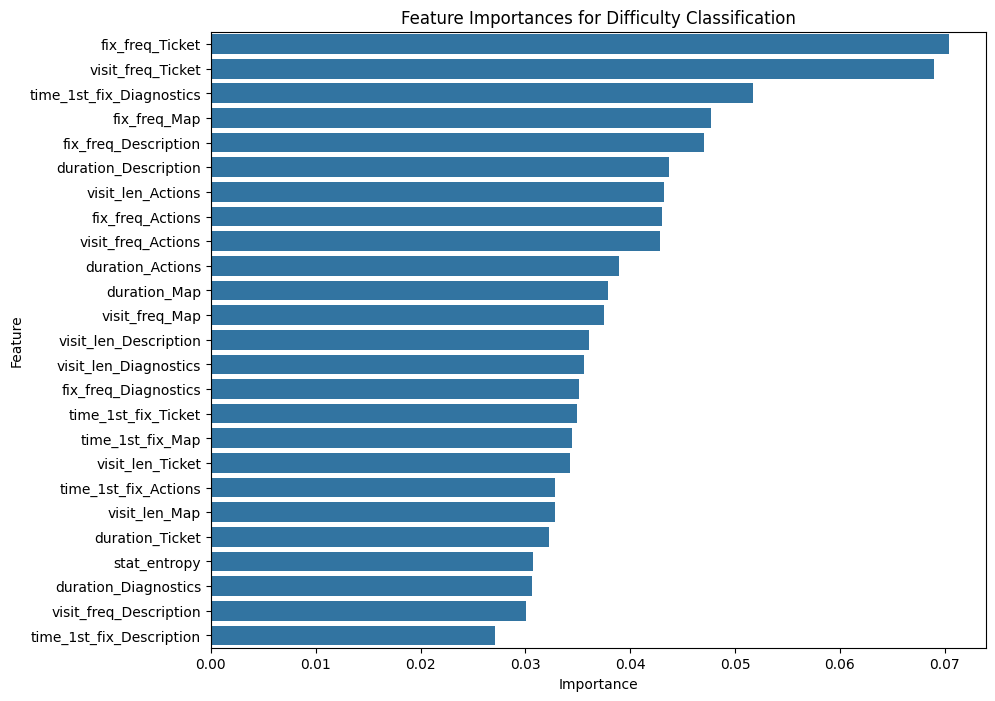

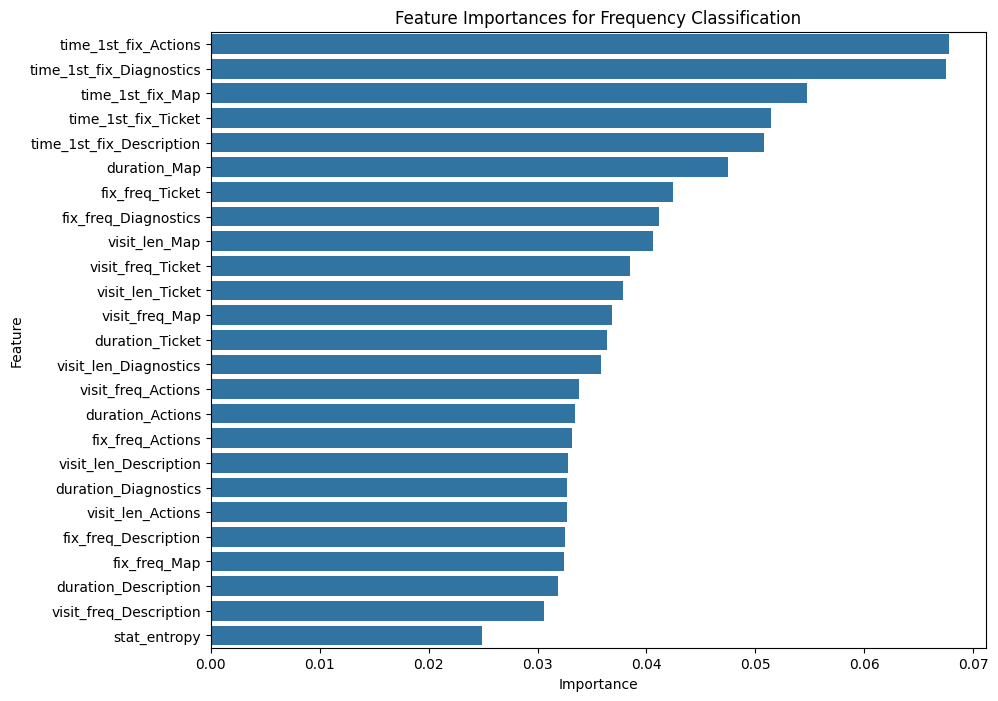

In [54]:
# Fit model and plot Feature Importances
feature_importance_tracker_diff = pd.DataFrame(0, index=X.columns, columns=range(1, 101))
feature_importance_tracker_freq= pd.DataFrame(0, index=X.columns, columns=range(1, 101))

for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', n_estimators=100, random_state=random_state, class_weight='balanced')
    multi_rf = MultiOutputClassifier(rf)

    multi_rf.fit(X, y)
    feature_importance_tracker_diff[random_state] = multi_rf.estimators_[0].feature_importances_
    feature_importance_tracker_freq[random_state] = multi_rf.estimators_[1].feature_importances_

feature_importances_avg_diff = feature_importance_tracker_diff.mean(axis=1).sort_values(ascending=False).reset_index()
feature_importances_avg_diff.columns = ['feature', 'importance_avg']
feature_importances_avg_freq = feature_importance_tracker_freq.mean(axis=1).sort_values(ascending=False).reset_index()
feature_importances_avg_freq.columns = ['feature', 'importance_avg']

# Plotting the average feature importance for both labels
plt.figure(figsize=(10, 8))
sns.barplot(x='importance_avg', y='feature', data=feature_importances_avg_diff)
plt.title("Feature Importances for Difficulty Classification")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()

plt.figure(figsize=(10, 8))
sns.barplot(x='importance_avg', y='feature', data=feature_importances_avg_freq)
plt.title("Feature Importances for Frequency Classification")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()

##### Multi-class Random Forest Classifier

In [55]:
# Prepare variables
features = [
    'duration_Ticket',
    'duration_Description',
    'duration_Map',
    'duration_Diagnostics',
    'duration_Actions',
    'fix_count_Description',
    'fix_count_Diagnostics',
    'fix_count_Actions',
    'time_1st_fix_Ticket',
    'time_1st_fix_Description',
    'time_1st_fix_Map',
    'time_1st_fix_Diagnostics',
    'time_1st_fix_Actions',
    'visit_count_Ticket',
    'visit_count_Description',
    'visit_count_Map',
    'visit_count_Diagnostics',
    'visit_len_Ticket',
    'visit_len_Description',
    'visit_len_Map',
    'visit_len_Diagnostics',
    'visit_len_Actions',
    'dwell_pct_Ticket',
    'dwell_pct_Description',
    'dwell_pct_Map',
    'dwell_pct_Diagnostics',
    'dwell_pct_Actions',
    'stat_entropy',
    'trans_entropy'
]

X = df_long_expanded.drop(columns=['participant_id', 'condition', 'difficulty', 'frequency', 'instance'])
y = df_long_expanded['condition'].map({
    "Easy_Slow": 0,
    "Easy_Fast": 1,
    "Hard_Slow": 2,
    "Hard_Fast": 3
})

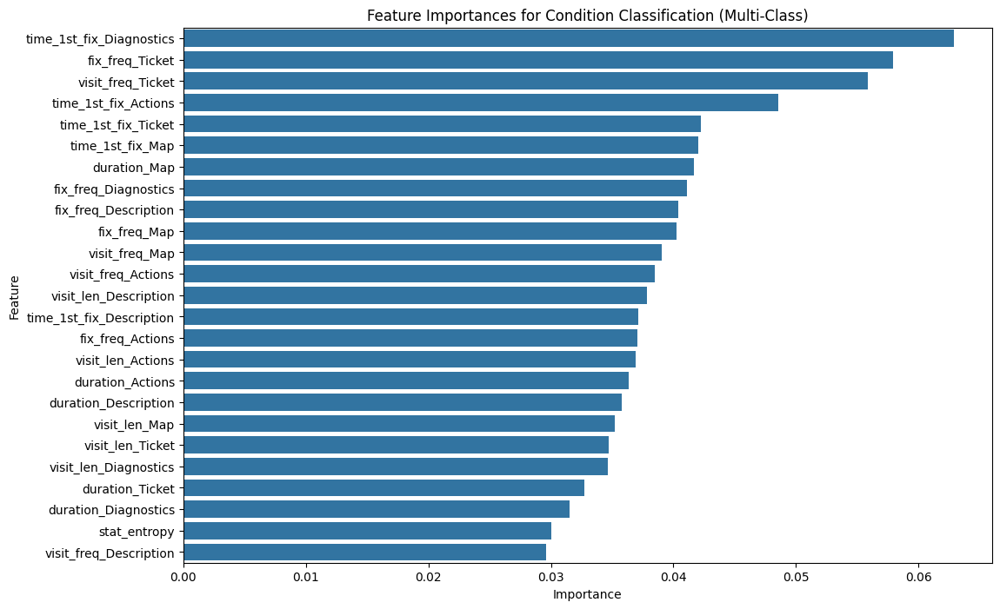

In [56]:
# Fit model and plot Feature Importances
feature_importance_tracker = pd.DataFrame(0, index=X.columns, columns=range(1, 101))
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', n_estimators=100, random_state=random_state, class_weight='balanced')
    rf.fit(X, y)
    feature_importance_tracker[random_state] = rf.feature_importances_

feature_importances_avg = feature_importance_tracker.mean(axis=1).sort_values(ascending=False).reset_index()
feature_importances_avg.columns = ['feature', 'importance_avg']

# Plotting the average feature importance
plt.figure(figsize=(12, 8))
sns.barplot(x='importance_avg', y='feature', data=feature_importances_avg)
plt.title("Feature Importances for Condition Classification (Multi-Class)")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()

##### Multi-class Boruta Feature Selection

In [57]:
# Prepare variables
X_cleaned = X.dropna()
y = df_long_expanded.dropna()['condition'].map({
    "Easy_Slow": 0,
    "Easy_Fast": 1,
    "Hard_Slow": 2,
    "Hard_Fast": 3
})

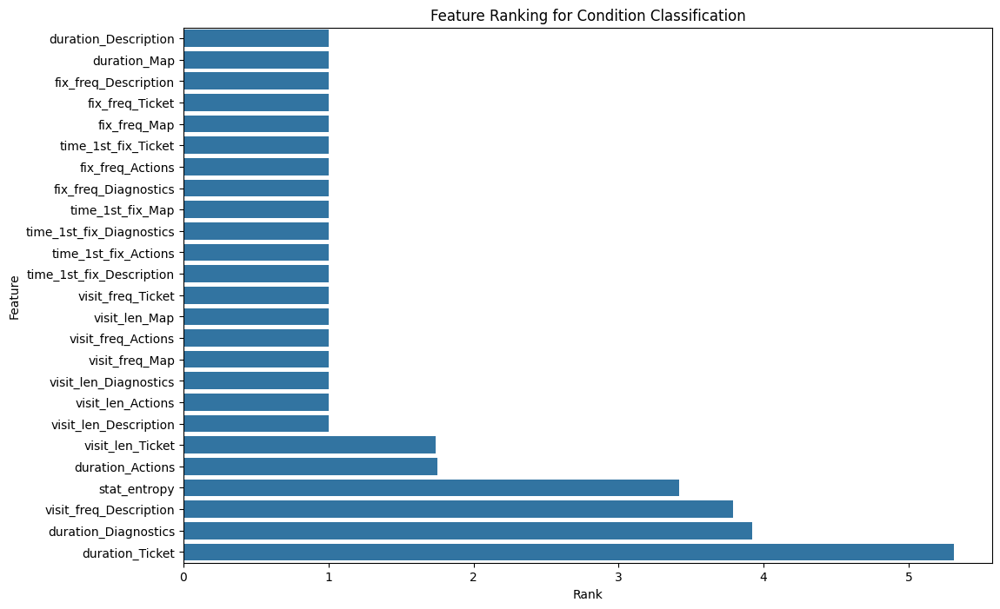

In [58]:
# Run Boruta Selection (max_depth=7)
ranking_dict = defaultdict(list)
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', max_depth=7, random_state=random_state, class_weight='balanced', n_jobs=-1)
    feat_selector = BorutaPy(rf, n_estimators='auto', random_state=random_state)
    
    feat_selector.fit(X_cleaned.values, y)
    for feature, rank in zip(X_cleaned.columns, feat_selector.ranking_):
        ranking_dict[feature].append(rank)

# Plot ranking
average_ranking = {feature: np.mean(ranks) for feature, ranks in ranking_dict.items()}
feature_ranking_df = pd.DataFrame({
    'feature': list(average_ranking.keys()),
    'rank_avg': list(average_ranking.values())
}).sort_values(by='rank_avg')

plt.figure(figsize=(12, 8))
sns.barplot(x='rank_avg', y='feature', data=feature_ranking_df)
plt.title("Feature Ranking for Condition Classification")
plt.xlabel("Rank")
plt.ylabel("Feature")
plt.show()

##### Multi-label Boruta Feature Selection (Diff)

In [59]:
# Prepare variables
X_cleaned = X.dropna()
y = df_long_expanded.dropna()['difficulty'].map({
    "Easy": 0,
    "Hard": 1
})

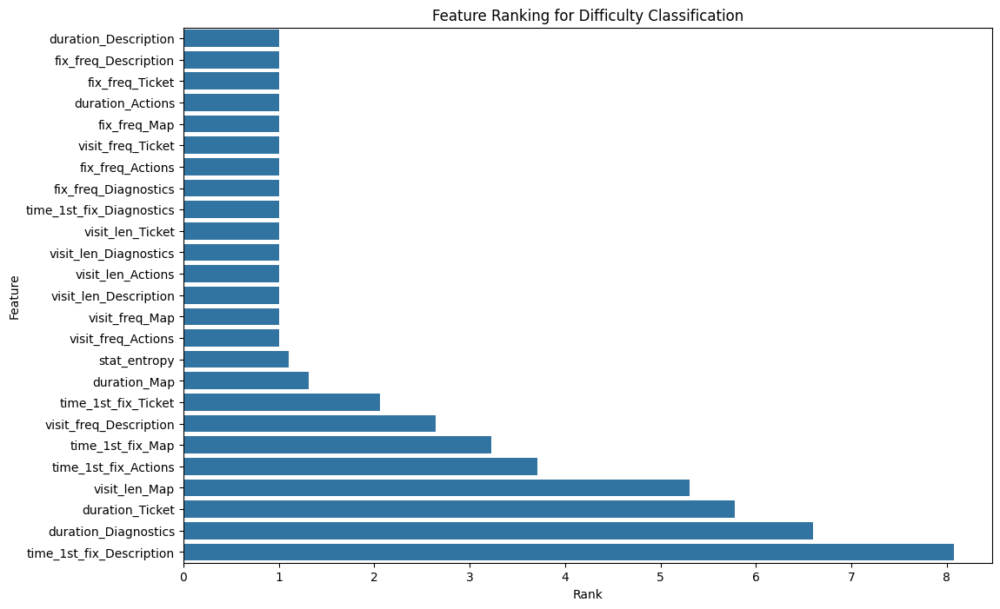

In [60]:
# Run Boruta Selection (max_depth=7)
ranking_dict = defaultdict(list)
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', max_depth=7, random_state=random_state, class_weight='balanced', n_jobs=-1)
    feat_selector = BorutaPy(rf, n_estimators='auto', random_state=random_state)
    
    feat_selector.fit(X_cleaned.values, y)
    for feature, rank in zip(X_cleaned.columns, feat_selector.ranking_):
        ranking_dict[feature].append(rank)

# Plot ranking
average_ranking = {feature: np.mean(ranks) for feature, ranks in ranking_dict.items()}
feature_ranking_df = pd.DataFrame({
    'feature': list(average_ranking.keys()),
    'rank_avg': list(average_ranking.values())
}).sort_values(by='rank_avg')

plt.figure(figsize=(12, 8))
sns.barplot(x='rank_avg', y='feature', data=feature_ranking_df)
plt.title("Feature Ranking for Difficulty Classification")
plt.xlabel("Rank")
plt.ylabel("Feature")
plt.show()

##### Multi-label Boruta Feature Selection (Freq)

In [61]:
# Prepare variables
X_cleaned = X.dropna()
y = df_long_expanded.dropna()['frequency'].map({
    "Slow": 0,
    "Fast": 1
})

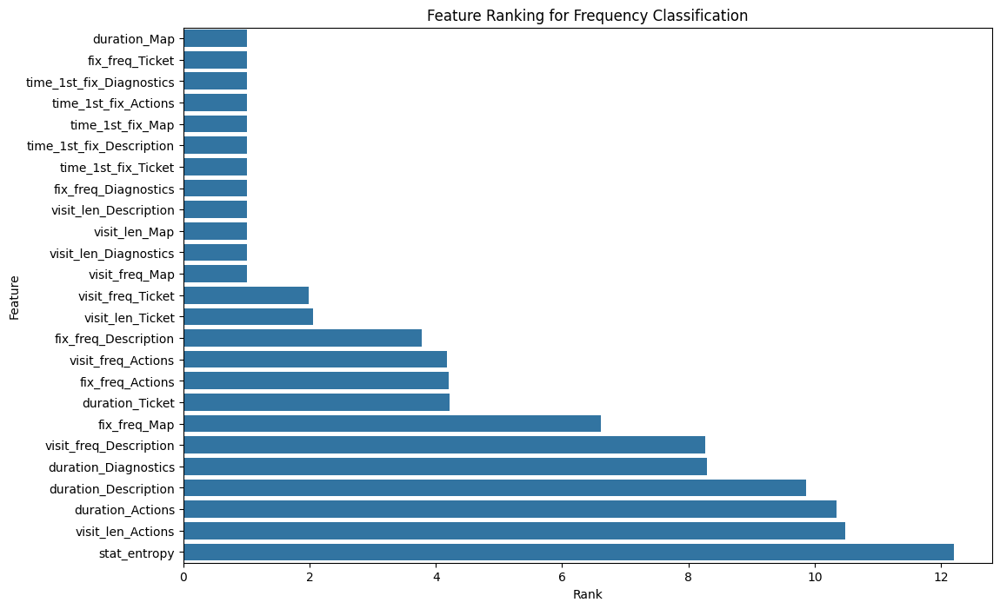

In [62]:
# Run Boruta Selection (max_depth=7)
ranking_dict = defaultdict(list)
for random_state in range(1, 101):
    rf = RandomForestClassifier(criterion='entropy', max_depth=7, random_state=random_state, class_weight='balanced', n_jobs=-1)
    feat_selector = BorutaPy(rf, n_estimators='auto', random_state=random_state)
    
    feat_selector.fit(X_cleaned.values, y)
    for feature, rank in zip(X_cleaned.columns, feat_selector.ranking_):
        ranking_dict[feature].append(rank)

# Plot ranking
average_ranking = {feature: np.mean(ranks) for feature, ranks in ranking_dict.items()}
feature_ranking_df = pd.DataFrame({
    'feature': list(average_ranking.keys()),
    'rank_avg': list(average_ranking.values())
}).sort_values(by='rank_avg')

plt.figure(figsize=(12, 8))
sns.barplot(x='rank_avg', y='feature', data=feature_ranking_df)
plt.title("Feature Ranking for Frequency Classification")
plt.xlabel("Rank")
plt.ylabel("Feature")
plt.show()

##### Select Best-Ranking Multi-Class Features

In [79]:
# Select columns
best_features = [
    "duration_Description",
    "duration_Map",

    "fix_freq_Ticket",
    "fix_freq_Description",
    "fix_freq_Diagnostics",
    "fix_freq_Actions",

    "time_1st_fix_Ticket",
    "time_1st_fix_Description",
    "time_1st_fix_Map",
    "time_1st_fix_Diagnostics",
    "time_1st_fix_Actions",

    "visit_freq_Ticket",
    "visit_freq_Map",
    "visit_freq_Actions",

    "visit_len_Description",
    "visit_len_Map",
    "visit_len_Diagnostics",
    "visit_len_Actions",
]

df_long_expanded_multi = df_long_expanded[['participant_id', 'condition'] + best_features]

##### Select Best-Ranking Multi-Label Features (Diff)

In [80]:
# Select columns
best_features = [
    "duration_Description",
    "duration_Actions",

    "fix_freq_Ticket",
    "fix_freq_Description",
    "fix_freq_Map",
    "fix_freq_Diagnostics",
    "fix_freq_Actions",

    "time_1st_fix_Diagnostics",

    "visit_freq_Ticket",
    "visit_freq_Map",
    "visit_freq_Actions",

    "visit_len_Ticket",
    "visit_len_Description",
    "visit_len_Diagnostics",
    "visit_len_Actions",
]
df_long_expanded_diff = df_long_expanded[['participant_id', 'difficulty'] + best_features]

##### Select Best-Ranking Multi-Label Features (Freq)

In [81]:
# Select columns
best_features = [
    "duration_Map",

    "fix_freq_Ticket",
    "fix_freq_Diagnostics",

    "time_1st_fix_Ticket",
    "time_1st_fix_Description",
    "time_1st_fix_Map",
    "time_1st_fix_Diagnostics",
    "time_1st_fix_Actions",
    
    "visit_freq_Map",
    
    "visit_len_Description",
    "visit_len_Map",
    "visit_len_Diagnostics",
]
df_long_expanded_freq = df_long_expanded[['participant_id', 'frequency'] + best_features]

### 3. Export Data

##### Multi-Class

In [82]:
# Prepare Dataset
df_long_expanded_multi[['difficulty', 'frequency']] = df_long_expanded_multi['condition'].str.split('_', expand=True)

cols = list(df_long_expanded_multi.columns)
cols.remove('difficulty')
cols.remove('frequency')
condition_index = cols.index('condition')
cols.insert(condition_index + 1, 'difficulty')
cols.insert(condition_index + 2, 'frequency')
df_long_expanded_multi = df_long_expanded_multi[cols]

C:\Users\vale_ad\AppData\Local\Temp\ipykernel_23936\1946996026.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_long_expanded_multi[['difficulty', 'frequency']] = df_long_expanded_multi['condition'].str.split('_', expand=True)
C:\Users\vale_ad\AppData\Local\Temp\ipykernel_23936\1946996026.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_long_expanded_multi[['difficulty', 'frequency']] = df_long_expanded_multi['condition'].str.split('_', expand=True)


In [88]:
# Export
df_long_expanded_multi.to_csv('./aoi_data/RQ3_features_mult.csv', index=False)

##### Multi-Label (Diff)

In [86]:
# Export
df_long_expanded_diff.to_csv('./aoi_data/RQ3_features_mult_diff.csv', index=False)

##### Multi-Label (Diff)

In [87]:
# Export
df_long_expanded_freq.to_csv('./aoi_data/RQ3_features_mult_freq.csv', index=False)